# Proyecto 1.- Extracción, limpieza, caracterización y análisis de datos

El proyecto consistirá en: 

 - Encontrar una fuente de datos libre y extraer los datos de la manera más automatizada posible.

 - Realizar una limpieza de datos nulos y gestión de valores extremos.

 - Crear o diseñar una serie de nuevas variables, categorizaciones, índices o kpis que nos aporten información de cara a un futuro análisis de datos.

 - Realizar el análisis de datos, obtener conclusiones relevantes de nuestro análisis, diferencias significativas entre las distintas dimensiones.
 
 - Presentación de 5 minutos para toda la clase. En powerpoint u otro formato similar, sin código, solo representaciones visuales y tablas, y conclusiones.

## Recomendación pasos a seguir:

 - Localiza la temática de datos que te gustaría extraer, trabajar y analizar, y encuentra una fuente de datos al respecto. Puede basarte en las propuestas a continuación o buscar una propia.
 - Inspecciona de manera general el alcance de esa fuente de datos, qué informaciones contiene, cuántas tablas, ficheros, líneas. Cuál es su granularidad (qué representa cada línea de las diferentes tablas de que dispones), el número de variables y su tipo.
 - Imagina y plantea qué análisis podrías realizar y a que conclusiones podrías llegar, qué querrías explicar o demostrar, y si con esos datos que tienes es posible, si son lo suficientemente ricos.
 - Extrae los datos. Nunca perdiendo de vista si aquello que planteaste sigue siendo posible de realizar, a medida que vas conociendo mejor los datos.
 - A continuación, sigue los pasos habituales del análisis exploratorio: limpieza de nulos, gestión de valores extremos, ingeniería de variables, representación y análisis de los datos.

## Extracción de datos

Preferiblemente la extracción de datos deberá realizarse a partir de una página web usando las técnicas de _web scraping_, por ejemplo recolectando los productos de una tienda o supermercado y sus características, para luego realizar un análisis de mercado. O bien a través de una API pública. Puedes usar alguno de las siguientes propuestas:

 1. [FACEIT](https://docs.faceit.com/api/data/) es una plataforma de gaming, en la que los jugadores se conectan, organizan partidas dependiendo del nivel... Proporciona un histórico de cada una de las partidas de cada jugador.
 
 2. [TRY plant database](https://www.try-db.org/TryWeb/Data.php#3) ofrece una serie de datasets con la información con la que se han desarrollado investigaciones científicas 
 
 3. [GBIF](https://techdocs.gbif.org/en/openapi/) API sobre información global de biodiversidad
 
 4. [Binance](https://developers.binance.com/docs/binance-spot-api-docs/web-socket-api/general-api-information) Es una plataforma de financial trading
 
 6. [yahoo finance](https://pypi.org/project/yfinance/) librería de python que ofrece los precios de las bolsas a nivel mundial día a día
 
 7. [EUROSTAT](https://ec.europa.eu/eurostat/web/main/data/database) bases de datos con información socioeconómica por paises de la UE
 
 - [50 apis publicas](https://mixedanalytics.com/blog/list-actually-free-open-no-auth-needed-apis/) 
 
 - [USA data](https://datausa.io/)
 
 - [Space X](https://github.com/r-spacex/SpaceX-API/tree/master)
 
 - [EMT Madrid: Bicimad](https://apidocs.emtmadrid.es/)
 
 - [OpenData Barcelona](https://opendata-ajuntament.barcelona.cat/data/es/dataset)
 
 - [Web scraping de idealista](https://scrapfly.io/blog/how-to-scrape-idealista/#idealista-scraping-summary)
 

In [1]:
import pandas as pd
import numpy as np
import plotly as px
import warnings
warnings.filterwarnings("ignore")

https://www.eea.europa.eu/en/datahub/featured-data/statistical-data/datahubitem-view/2de78980-dc09-444c-86f6-bec2b2629abd?activeAccordion=

In [2]:
# cleaning dataframe1

In [3]:
df1=pd.read_csv('eea_s_suso001_p_2013-2022_v01_r00.csv')

In [4]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 390 entries, 0 to 389
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   eu_sdg           390 non-null    object 
 1   dimension        390 non-null    object 
 2   dimension_label  390 non-null    object 
 3   unit             390 non-null    object 
 4   unit_label       390 non-null    object 
 5   geo              390 non-null    object 
 6   geo_label        390 non-null    object 
 7   time             390 non-null    int64  
 8   obs_value        280 non-null    float64
 9   obs_status       280 non-null    object 
dtypes: float64(1), int64(1), object(8)
memory usage: 30.6+ KB


In [5]:
df1.head()

,eu_sdg,dimension,dimension_label,unit,unit_label,geo,geo_label,time,obs_value,obs_status
0,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",EU27_2020,European Union - 27 countries (from 2020),2013,100.00,E
1,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",EU27_2020,European Union - 27 countries (from 2020),2014,103.52,E
2,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",EU27_2020,European Union - 27 countries (from 2020),2015,105.33,E
3,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",EU27_2020,European Union - 27 countries (from 2020),2016,106.16,E
4,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",EU27_2020,European Union - 27 countries (from 2020),2017,107.94,E


In [6]:
df1.drop(df1[df1['geo_label'] == 'European Union - 27 countries (from 2020)'].index, inplace=True)

In [7]:
df1.drop(df1[df1['geo_label'] == 'Kosovo (under United Nations Security Council Resolution 1244/99)'].index, inplace=True)

In [8]:
df1.head()

,eu_sdg,dimension,dimension_label,unit,unit_label,geo,geo_label,time,obs_value,obs_status
10,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2013,75.91,E
11,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2014,82.88,E
12,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2015,82.24,E
13,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2016,87.39,E
14,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2017,88.05,E


In [9]:
df1 = df1.rename(columns={'geo': 'Abbreviations', 'obs_value':'eco-index'})

In [10]:
df1.head()

,eu_sdg,dimension,dimension_label,unit,unit_label,Abbreviations,geo_label,time,eco-index,obs_status
10,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2013,75.91,E
11,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2014,82.88,E
12,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2015,82.24,E
13,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2016,87.39,E
14,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2017,88.05,E


In [11]:
#cleaning dataframe 2

In [12]:
df2=pd.read_csv('estat_hlth_cd_iap_filtered_en.csv')

In [13]:
df2.head()

,DATAFLOW,LAST UPDATE,freq,airpol,indic_he,unit,geo,TIME_PERIOD,OBS_VALUE,OBS_FLAG,CONF_STATUS
0,ESTAT:HLTH_CD_IAP(1.0),03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Albania,2013,4297,NaN,NaN
1,ESTAT:HLTH_CD_IAP(1.0),03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Albania,2014,3333,NaN,NaN
2,ESTAT:HLTH_CD_IAP(1.0),03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Albania,2015,4660,NaN,NaN
3,ESTAT:HLTH_CD_IAP(1.0),03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Albania,2016,5138,NaN,NaN
4,ESTAT:HLTH_CD_IAP(1.0),03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Albania,2017,5280,NaN,NaN


In [14]:
df2['geo'].unique()

array(['Albania', 'Austria', 'Bosnia and Herzegovina', 'Belgium',
       'Bulgaria', 'Switzerland', 'Cyprus', 'Czechia', 'Germany',
       'Denmark', 'Estonia', 'Greece', 'Spain', 'Finland', 'France',
       'Croatia', 'Hungary', 'Ireland', 'Iceland', 'Italy',
       'Liechtenstein', 'Lithuania', 'Luxembourg', 'Latvia', 'Montenegro',
       'North Macedonia', 'Malta', 'Netherlands', 'Norway', 'Poland',
       'Portugal', 'Romania', 'Serbia', 'Sweden', 'Slovenia', 'Slovakia',
       'Kosovo*'], dtype=object)

In [15]:
df2.drop(df2[df2['geo'] == 'Kosovo*'].index, inplace=True)

In [16]:
df2 = df2.rename(columns={'OBS_VALUE': 'Deaths'})

In [17]:
df2.head()

,DATAFLOW,LAST UPDATE,freq,airpol,indic_he,unit,geo,TIME_PERIOD,Deaths,OBS_FLAG,CONF_STATUS
0,ESTAT:HLTH_CD_IAP(1.0),03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Albania,2013,4297,NaN,NaN
1,ESTAT:HLTH_CD_IAP(1.0),03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Albania,2014,3333,NaN,NaN
2,ESTAT:HLTH_CD_IAP(1.0),03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Albania,2015,4660,NaN,NaN
3,ESTAT:HLTH_CD_IAP(1.0),03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Albania,2016,5138,NaN,NaN
4,ESTAT:HLTH_CD_IAP(1.0),03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Albania,2017,5280,NaN,NaN


In [18]:
df2.columns

Index(['DATAFLOW', 'LAST UPDATE', 'freq', 'airpol', 'indic_he', 'unit', 'geo',
       'TIME_PERIOD', 'Deaths', 'OBS_FLAG', 'CONF_STATUS'],
      dtype='object')

In [ ]:
#Merging both DataFrames

In [19]:
df3=pd.merge(df1, df2, left_on=['geo_label', 'time'], right_on=['geo','TIME_PERIOD'], how='inner')

In [20]:
df3

,eu_sdg,dimension,dimension_label,unit_x,unit_label,Abbreviations,geo_label,time,eco-index,obs_status,...,LAST UPDATE,freq,airpol,indic_he,unit_y,geo,TIME_PERIOD,Deaths,OBS_FLAG,CONF_STATUS
0,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2013,75.91,E,...,03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Belgium,2013,8690,NaN,NaN
1,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2014,82.88,E,...,03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Belgium,2014,6256,NaN,NaN
2,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2015,82.24,E,...,03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Belgium,2015,6214,NaN,NaN
3,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2016,87.39,E,...,03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Belgium,2016,5775,NaN,NaN
4,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",BE,Belgium,2017,88.05,E,...,03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Belgium,2017,5679,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
355,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",RS,Serbia,2018,NaN,NaN,...,03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Serbia,2018,14716,NaN,NaN
356,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",RS,Serbia,2019,NaN,NaN,...,03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Serbia,2019,11130,NaN,NaN
357,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",RS,Serbia,2020,NaN,NaN,...,03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Serbia,2020,14381,NaN,NaN
358,suso001,I13,Eco-innovation index,I13,"Index, 2013 = 100",RS,Serbia,2021,NaN,NaN,...,03/02/25 23:00:00,Annual,Particulates < 2.5µm,Premature death,Number,Serbia,2021,14850,NaN,NaN


In [21]:
deaths_ecoindex=df3[['geo','time','Deaths','eco-index']]

In [22]:
deaths_ecoindex.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 360 entries, 0 to 359
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   geo        360 non-null    object 
 1   time       360 non-null    int64  
 2   Deaths     360 non-null    int64  
 3   eco-index  270 non-null    float64
dtypes: float64(1), int64(2), object(1)
memory usage: 11.4+ KB


In [23]:
for i in list(deaths_ecoindex['geo'].unique()):
    print(i)
    print(deaths_ecoindex[deaths_ecoindex['geo'] == i].isnull())
    print('\n')

Belgium
     geo   time  Deaths  eco-index
0  False  False   False      False
1  False  False   False      False
2  False  False   False      False
3  False  False   False      False
4  False  False   False      False
5  False  False   False      False
6  False  False   False      False
7  False  False   False      False
8  False  False   False      False
9  False  False   False      False


Bulgaria
      geo   time  Deaths  eco-index
10  False  False   False      False
11  False  False   False      False
12  False  False   False      False
13  False  False   False      False
14  False  False   False      False
15  False  False   False      False
16  False  False   False      False
17  False  False   False      False
18  False  False   False      False
19  False  False   False      False


Czechia
      geo   time  Deaths  eco-index
20  False  False   False      False
21  False  False   False      False
22  False  False   False      False
23  False  False   False      False
24  False 

In [24]:
deaths_ecoindex=deaths_ecoindex.fillna(1)

In [25]:
deaths_ecoindex['time'].unique()

array([2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022])

In [26]:
deaths_ecoindex['geo'].unique()

array(['Belgium', 'Bulgaria', 'Czechia', 'Denmark', 'Germany', 'Estonia',
       'Ireland', 'Greece', 'Spain', 'France', 'Croatia', 'Italy',
       'Cyprus', 'Latvia', 'Lithuania', 'Luxembourg', 'Hungary', 'Malta',
       'Netherlands', 'Austria', 'Poland', 'Portugal', 'Romania',
       'Slovenia', 'Slovakia', 'Finland', 'Sweden', 'Iceland',
       'Liechtenstein', 'Norway', 'Switzerland', 'Bosnia and Herzegovina',
       'Montenegro', 'North Macedonia', 'Albania', 'Serbia'], dtype=object)

In [27]:
comp=pd.DataFrame()
d=[]
ei=[]
for country in list(deaths_ecoindex['geo'].unique()):
    i=deaths_ecoindex[deaths_ecoindex['geo'] == country]
    d.append(int(i[i['time'] == 2022]['Deaths'])- int(i[i['time'] == 2013]['Deaths']))
    ei.append(int(i[i['time'] == 2022]['eco-index']) -  int(i[i['time'] == 2013]['eco-index']))

In [28]:
comp['country'] = deaths_ecoindex['geo'].unique()
comp['deaths_int'] = d
comp['eco-index_int'] =ei

In [29]:
import plotly.graph_objects as go 

fig = go.Figure(data=go.Choropleth(
    locations = comp['country'],
    locationmode = 'country names',
    z = comp['eco-index_int'],
    text = comp['country'],
    colorscale = 'Greens_r',
    autocolorscale = False,
    reversescale = True,
    marker_line_color = 'darkgray',
    marker_line_width = 0.5,
    colorbar_title = 'Eco-Index',
))

# Actualizar el diseño
fig.update_layout(
    title_text = 'Evolución del Eco-Index por país en Europa (2013-2022)', 
    geo_scope = 'europe',
    width = 1200,
    height = 900,title_font_size=30,
)

fig.show()

In [30]:
fig = go.Figure(data=go.Choropleth(
    locations = comp['country'],
    locationmode = 'country names',
    z = comp['deaths_int'],
    text = comp['country'],
    colorscale = 'Reds_r',
    autocolorscale = False,
    reversescale = True,
    marker_line_color = 'darkgray',
    marker_line_width = 0.5,
    colorbar_title = 'Descenso de muertes',
))

# Actualizar el diseño
fig.update_layout(
    title_text = 'Evolución de muertes prematuras por país en Europa (2013-2022)', 
    geo_scope = 'europe',
    width = 1200,
    height = 900,title_font_size=30,
)

fig.show()

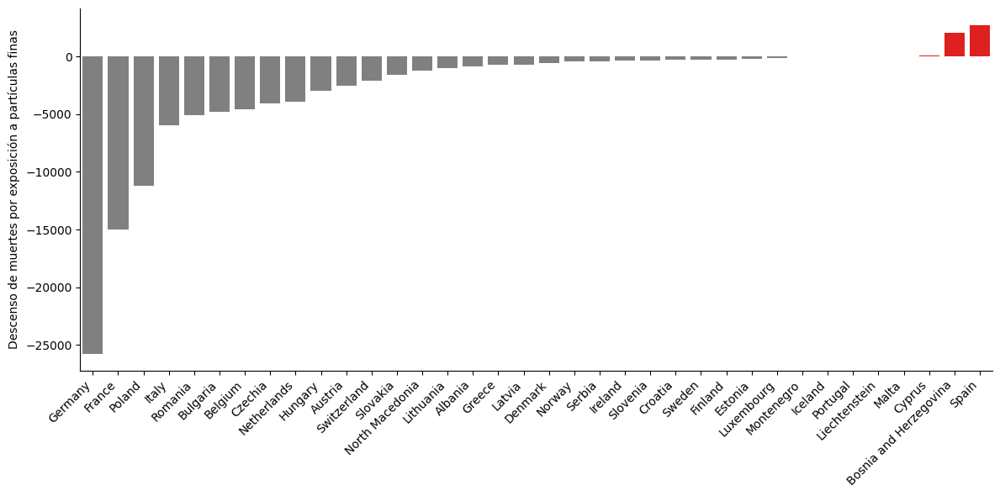

In [31]:
import seaborn as sns
import matplotlib.pyplot as plt

comp_sorted = comp.sort_values(by='deaths_int', ascending=True)

colors = ['red' if country == 'Spain' else 'red' if country == 'Cyprus' else 'red' if country == 'Bosnia and Herzegovina' else 'gray' for country in comp_sorted['country']]

plt.figure(figsize=(12, 6))
ax= sns.barplot(data=comp_sorted, x='country', y='deaths_int', palette=colors)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Rotar las etiquetas del eje x
plt.xticks(rotation=45, ha='right')
plt.xlabel('')
plt.ylabel('Descenso de muertes por exposición a partículas finas')
# Ajustar el diseño
plt.tight_layout()

# Mostrar el gráfico
plt.show()

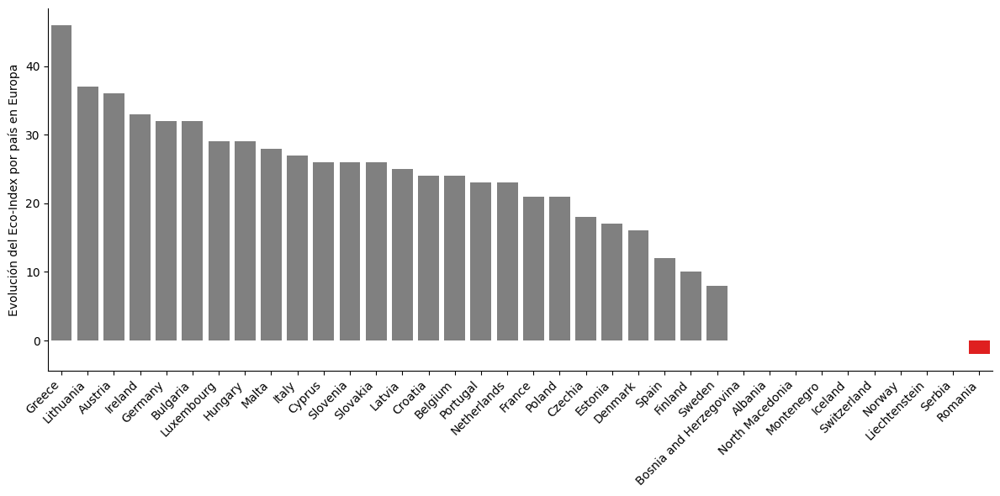

In [32]:
import seaborn as sns
import matplotlib.pyplot as plt

comp_sorted = comp.sort_values(by='eco-index_int', ascending=False)
colors = ['red' if country == 'Romania' else 'gray' for country in comp_sorted['country']]

plt.figure(figsize=(12, 6))
ax= sns.barplot(data=comp_sorted, x='country', y='eco-index_int', palette=colors)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Rotar las etiquetas del eje x
plt.xticks(rotation=45, ha='right')
plt.xlabel('')
plt.ylabel('Evolución del Eco-Index por país en Europa')
# Ajustar el diseño
plt.tight_layout()

# Mostrar el gráfico
plt.show()

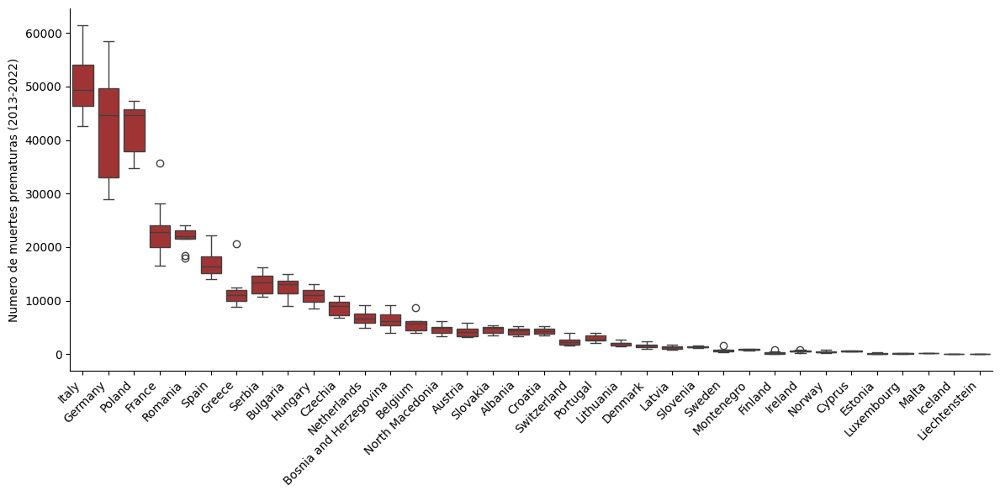

In [33]:
plt.figure(figsize=(12,6))
de_sorted = deaths_ecoindex.sort_values(by='Deaths', ascending=False)
ax= sns.boxplot(data=de_sorted, x='geo', y='Deaths', color='firebrick')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.xticks(rotation=45, ha='right')
plt.ylabel('Numero de muertes prematuras (2013-2022)')
plt.xlabel('')
plt.tight_layout()
plt.savefig('boxplot_deaths.png',dpi=300)


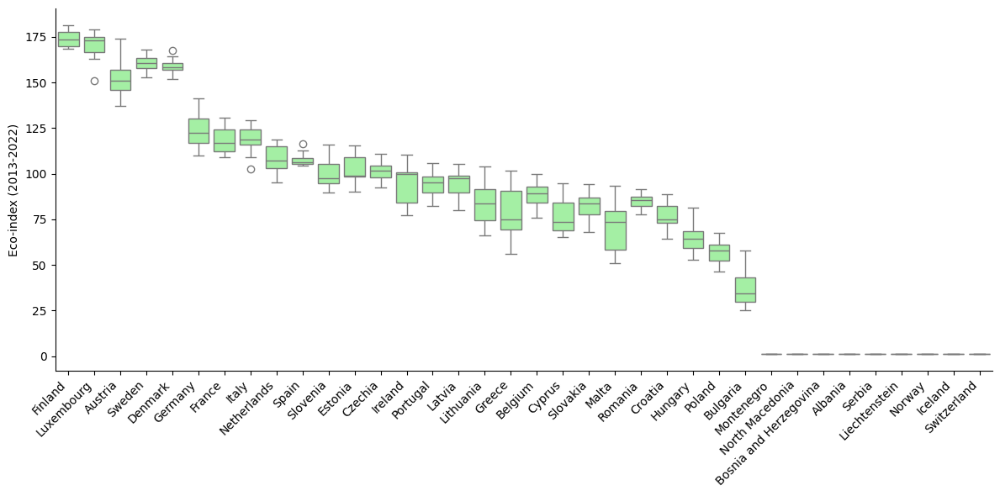

In [34]:
plt.figure(figsize=(12,6))
de_sorted = deaths_ecoindex.sort_values(by='eco-index', ascending=False)
ax= sns.boxplot(data=de_sorted, x='geo', y='eco-index', color='palegreen')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.xticks(rotation=45, ha='right')
plt.ylabel('Eco-index (2013-2022)')
plt.xlabel('')
plt.tight_layout()
plt.savefig('boxplot_ecoindex.png',dpi=300)

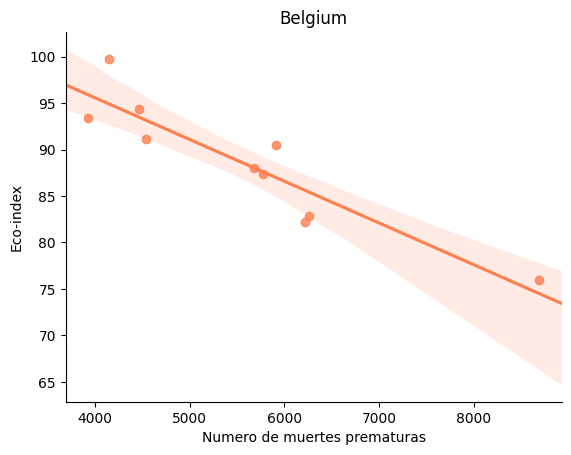

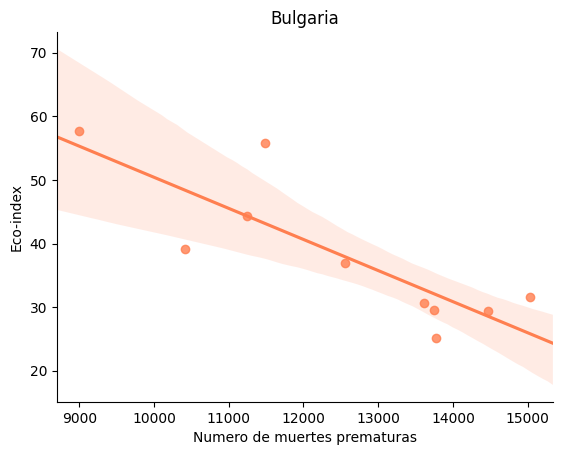

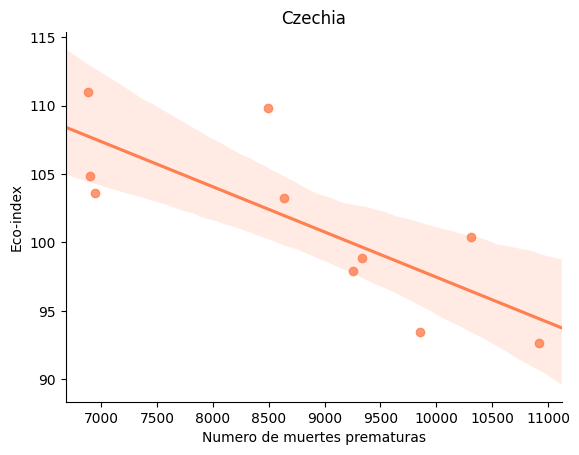

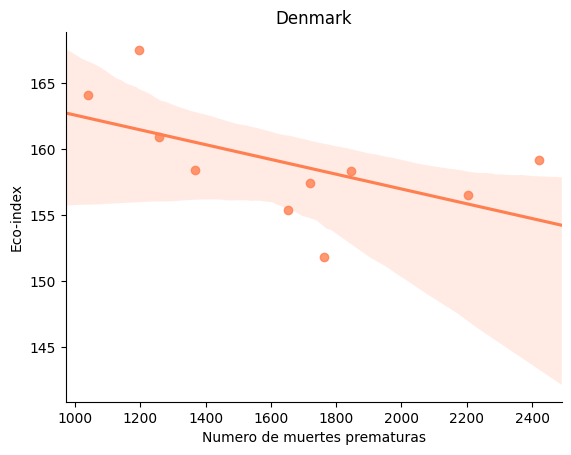

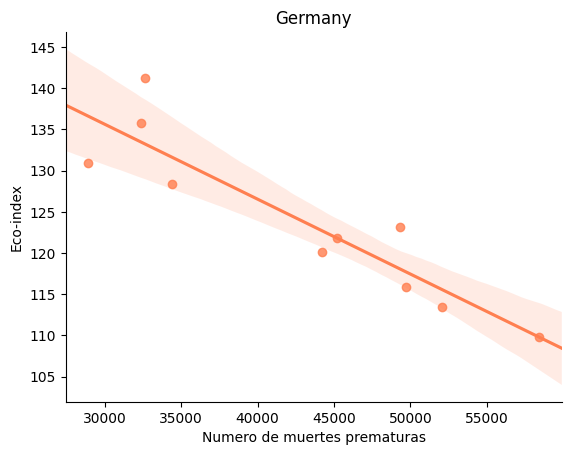

...

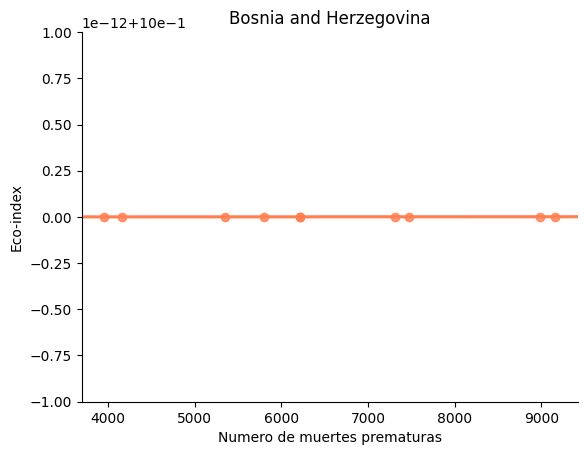

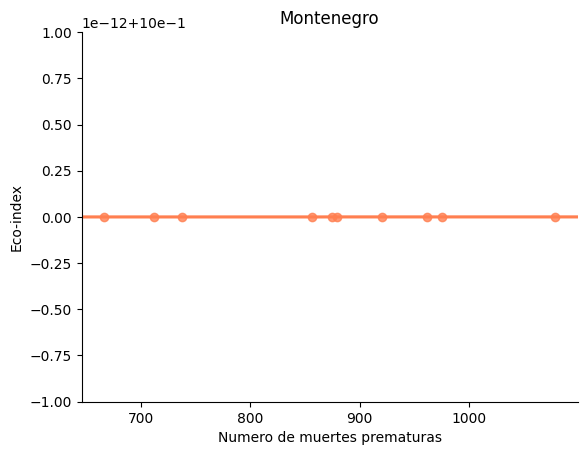

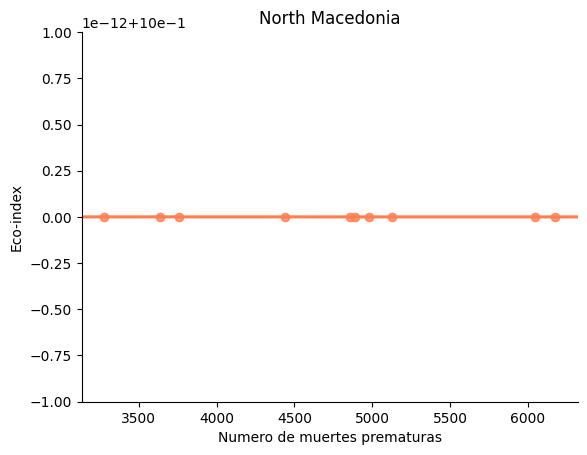

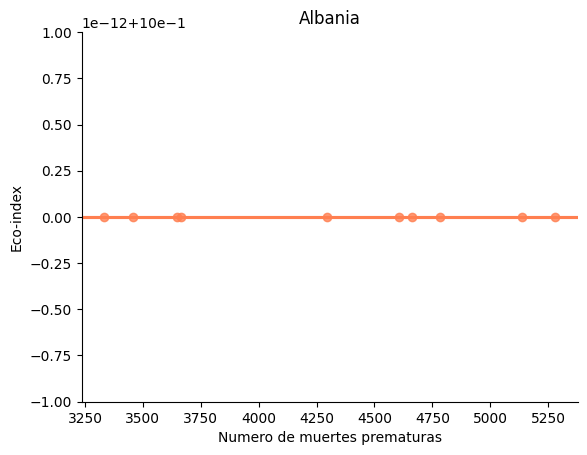

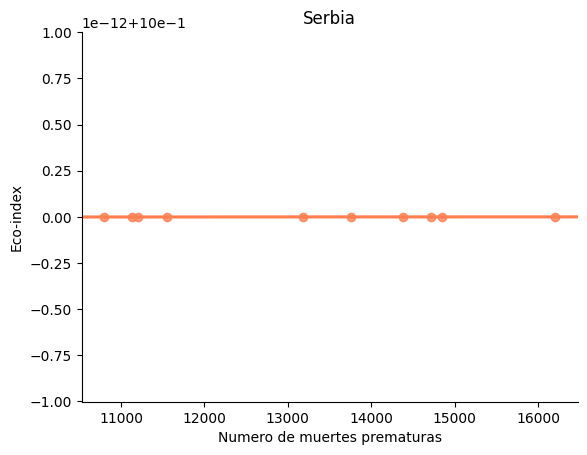

In [43]:
###Regplot without same scale for eco-index
for country in list(deaths_ecoindex['geo'].unique()):
    df= deaths_ecoindex[deaths_ecoindex['geo'] ==country]
    ax = sns.regplot(data=df, x='Deaths', y='eco-index',
                   truncate=False,
                  color="coral")
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    plt.title(country)
    plt.ylabel('Eco-index')
    plt.xlabel('Numero de muertes prematuras')
    plt.savefig(f'Figures_without_same_scale/{country}_reg.png', dpi=300)
    plt.show()

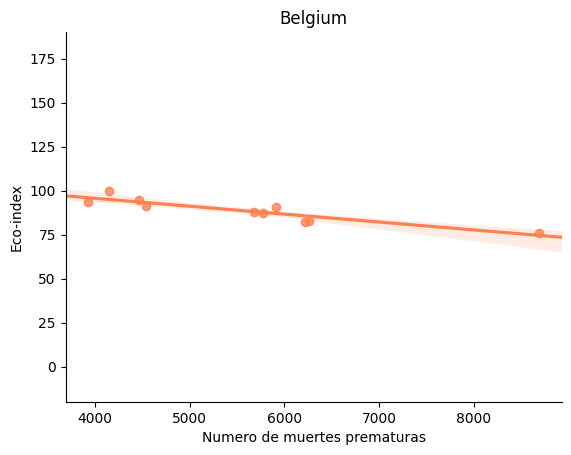

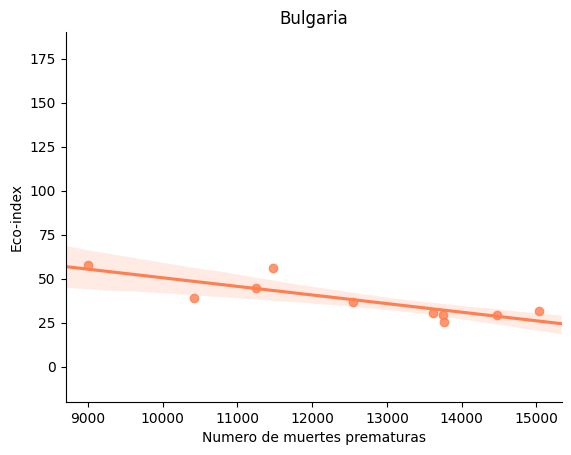

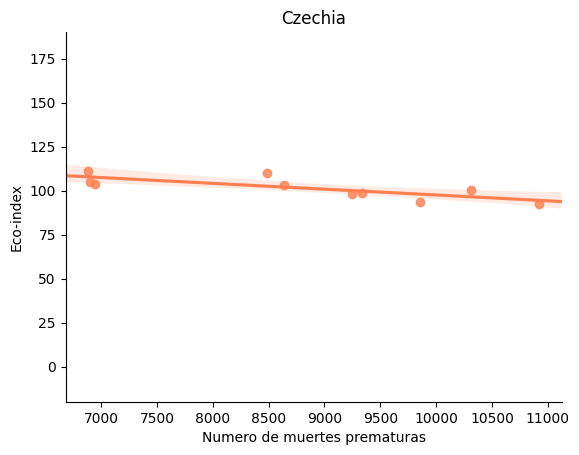

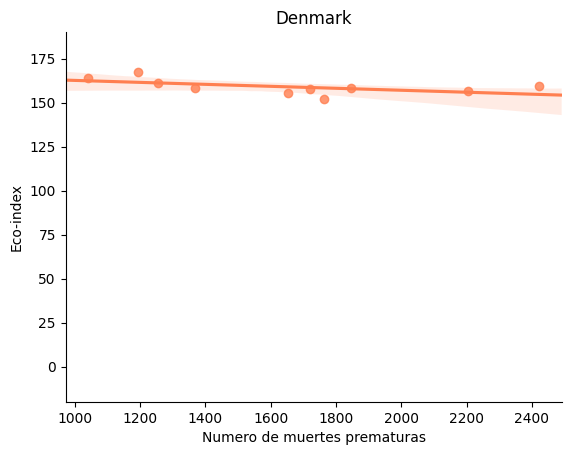

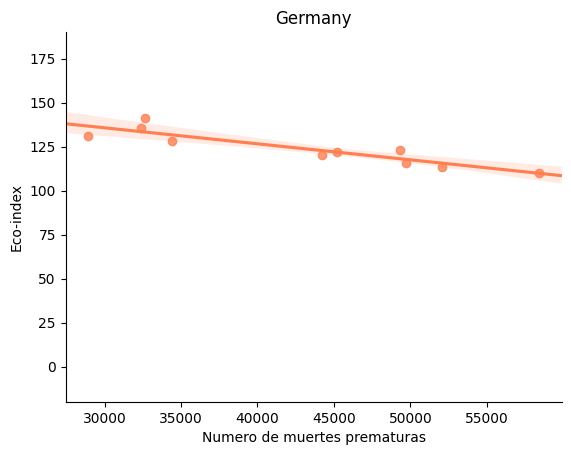

...

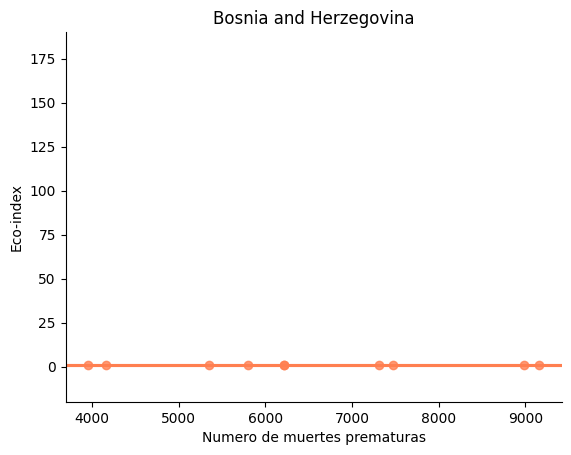

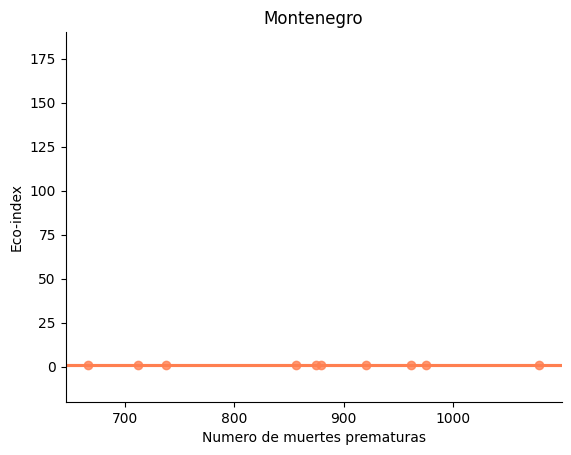

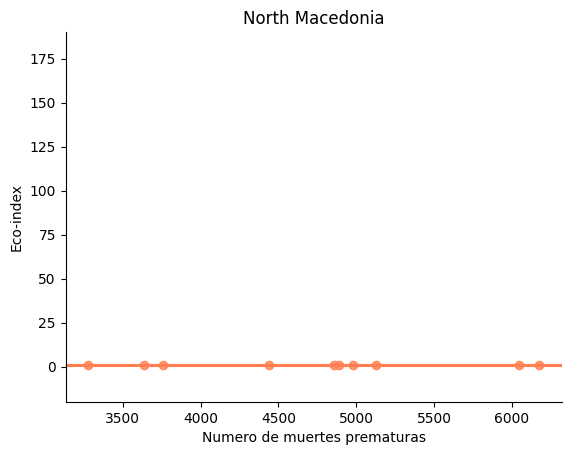

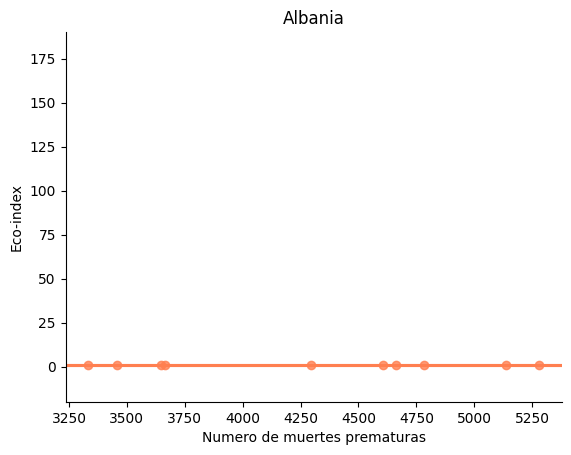

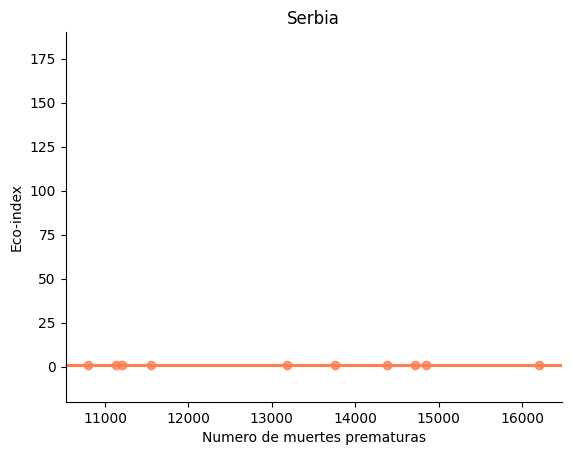

In [44]:
### Regplot with same scale for eco-index
for country in list(deaths_ecoindex['geo'].unique()):
    df= deaths_ecoindex[deaths_ecoindex['geo'] ==country]
    ax = sns.regplot(data=df, x='Deaths', y='eco-index',
                   truncate=False,
                  color="coral")
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    plt.ylim(-20,190)
    plt.title(country)
    plt.ylabel('Eco-index')
    plt.xlabel('Numero de muertes prematuras')
    plt.savefig(f'Figures_with_same_scale/{country}_reg.png', dpi=300)
    plt.show()

In [36]:
neg=['Belgium','Bulgaria','Czechia','Denmark','Germnany','Estonia','France','Italy','Latvia','Lithuania','Luxemburgo','Netherlands','Austria','Slovenia','Slovakia']
pos=['Cyprus','Malta','Romania']
neut=['Spain', 'Ireland', 'Greece', 'Finland', 'Sweden','Hungary','Portugal', 'Poland']

In [37]:
conc=pd.DataFrame()
reg=[]
cols=[]
conc['country'] = comp['country']
for country in conc['country']:
    if country in neg:
        reg.append(100)
        cols.append('palegreen')
    elif country in pos:
        reg.append(-100)
        cols.append('coral')
    elif country in neut:
        reg.append(50)
        cols.append('lightblue')
    else:
        reg.append(0)
        cols.append('white')

conc['reg'] = reg
conc['color'] = cols

In [38]:
conc

,country,reg,color
0,Belgium,100,palegreen
1,Bulgaria,100,palegreen
2,Czechia,100,palegreen
3,Denmark,100,palegreen
4,Germany,0,white
5,Estonia,100,palegreen
6,Ireland,50,lightblue
7,Greece,50,lightblue
8,Spain,50,lightblue
9,France,100,palegreen


In [39]:
fig = go.Figure()

for country in conc['country'].unique():
    df_country = conc[conc['country'] == country]
    fig.add_trace(go.Scattergeo(
        locations=[country],
        locationmode='country names',
        marker=dict(
            color=df_country['color'].iloc[0], 
            line_color='darkgray',
            line_width=0.5
        ,size=12),
        name=country  
    ))

fig.update_layout(
    title_text='Evolución de muertes prematuras por país en Europa (2013-2022)',
    geo_scope='world',
    width=1200,
    height=900,
    title_font_size=30,
    showlegend=False 
)

fig.show()